<span style="color:#23CBE2;font-weight:700;font-size:30px">
   


# - - Crime Data Science Project - -
    
</span>
<hr/>

<div class="alert alert-info"> By Sarah Braverman </div>
<hr/>

<span style="color:#23CBE2;font-weight:700;font-size:20px">
   


# - - Preliminary Code - -
    
    
</span>

<hr/>

Fun styling html: https://towardsdatascience.com/enrich-your-jupyter-notebook-with-these-tips-55c8ead25255#:~:text=%F0%9F%8E%A8%201.&text=We%20can%20use%20colour%20names,this%20may%20come%20in%20handy.

Importing extras that I'll need and the csv

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

crimes_raw = pd.read_csv("crime.csv")

Making it so that I can see all of the data frame
https://www.geeksforgeeks.org/how-to-print-an-entire-pandas-dataframe-in-python/

In [2]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

Making a profiling report and a separate file for the profiling report

In [3]:
# import pandas_profiling
# profile = crimes.profile_report(title='Boston Crimes Profiling')
# profile.to_file(output_file='boston-crimes-profiling.html')

Making it in a datetime format
https://stackoverflow.com/questions/26763344/convert-pandas-column-to-datetime 

In [4]:
crimes_raw['OCCURRED_ON_DATE'] =  pd.to_datetime(crimes_raw['OCCURRED_ON_DATE'], infer_datetime_format=True)

Looking at the first five and last five rows of the data set

In [5]:
crimes_raw.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
0,I182070945,619,Larceny,LARCENY ALL OTHERS,D14,808.0,NaN,2018-09-02 13:00:00,2018,9,Sunday,13,Part One,LINCOLN ST,42.357791,-71.139371,"(42.35779134, -71.13937053)"
1,I182070943,1402,Vandalism,VANDALISM,C11,347.0,NaN,2018-08-21 00:00:00,2018,8,Tuesday,0,Part Two,HECLA ST,42.306821,-71.060300,"(42.30682138, -71.06030035)"
2,I182070941,3410,Towed,TOWED MOTOR VEHICLE,D4,151.0,NaN,2018-09-03 19:27:00,2018,9,Monday,19,Part Three,CAZENOVE ST,42.346589,-71.072429,"(42.34658879, -71.07242943)"
3,I182070940,3114,Investigate Property,INVESTIGATE PROPERTY,D4,272.0,NaN,2018-09-03 21:16:00,2018,9,Monday,21,Part Three,NEWCOMB ST,42.334182,-71.078664,"(42.33418175, -71.07866441)"
4,I182070938,3114,Investigate Property,INVESTIGATE PROPERTY,B3,421.0,NaN,2018-09-03 21:05:00,2018,9,Monday,21,Part Three,DELHI ST,42.275365,-71.090361,"(42.27536542, -71.09036101)"


In [6]:
crimes_raw.tail()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
319068,I050310906-00,3125,Warrant Arrests,WARRANT ARREST,D4,285.0,NaN,2016-06-05 17:25:00,2016,6,Sunday,17,Part Three,COVENTRY ST,42.336951,-71.085748,"(42.33695098, -71.08574813)"
319069,I030217815-08,111,Homicide,"MURDER, NON-NEGLIGIENT MANSLAUGHTER",E18,520.0,NaN,2015-07-09 13:38:00,2015,7,Thursday,13,Part One,RIVER ST,42.255926,-71.123172,"(42.25592648, -71.12317207)"
319070,I030217815-08,3125,Warrant Arrests,WARRANT ARREST,E18,520.0,NaN,2015-07-09 13:38:00,2015,7,Thursday,13,Part Three,RIVER ST,42.255926,-71.123172,"(42.25592648, -71.12317207)"
319071,I010370257-00,3125,Warrant Arrests,WARRANT ARREST,E13,569.0,NaN,2016-05-31 19:35:00,2016,5,Tuesday,19,Part Three,NEW WASHINGTON ST,42.302333,-71.111565,"(42.30233307, -71.11156487)"
319072,142052550,3125,Warrant Arrests,WARRANT ARREST,D4,903.0,NaN,2015-06-22 00:12:00,2015,6,Monday,0,Part Three,WASHINGTON ST,42.333839,-71.080290,"(42.33383935, -71.08029038)"


Checking all of the datatypes and looking at the non-null data

In [7]:
crimes_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 319073 entries, 0 to 319072
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   INCIDENT_NUMBER      319073 non-null  object        
 1   OFFENSE_CODE         319073 non-null  int64         
 2   OFFENSE_CODE_GROUP   319073 non-null  object        
 3   OFFENSE_DESCRIPTION  319073 non-null  object        
 4   DISTRICT             317308 non-null  object        
 5   REPORTING_AREA       298823 non-null  float64       
 6   SHOOTING             1019 non-null    object        
 7   OCCURRED_ON_DATE     319073 non-null  datetime64[ns]
 8   YEAR                 319073 non-null  int64         
 9   MONTH                319073 non-null  int64         
 10  DAY_OF_WEEK          319073 non-null  object        
 11  HOUR                 319073 non-null  int64         
 12  UCR_PART             318983 non-null  object        
 13  STREET        

Seeing the crimes data before changing it to a boolean

In [8]:
crimes_before  = crimes_raw["SHOOTING"]
crimes_before

0         NaN
1         NaN
2         NaN
3         NaN
4         NaN
5         NaN
6         NaN
7         NaN
8         NaN
9         NaN
10        NaN
11        NaN
12        NaN
13        NaN
14        NaN
15        NaN
16        NaN
17        NaN
18        NaN
19        NaN
20        NaN
21        NaN
22        NaN
23        NaN
24        NaN
25        NaN
26        NaN
27        NaN
28        NaN
29        NaN
30        NaN
31        NaN
32        NaN
33        NaN
34        NaN
35        NaN
36        NaN
37        NaN
38        NaN
39        NaN
40        NaN
41        NaN
42        NaN
43        NaN
44        NaN
45        NaN
46        NaN
47        NaN
48        NaN
49        NaN
50        NaN
51        NaN
52        NaN
53        NaN
54        NaN
55        NaN
56        NaN
57        NaN
58        NaN
59        NaN
60        NaN
61        NaN
62        NaN
63        NaN
64        NaN
65        NaN
66        NaN
67        NaN
68        NaN
69        NaN
70        NaN
71    

In [9]:
crimes = crimes_raw.copy()                          
crimes['SHOOTING'] = crimes['SHOOTING'].map({'Y': True, np.nan : False})

In [10]:
crimes['SHOOTING']

0         False
1         False
2         False
3         False
4         False
5         False
6         False
7         False
8         False
9         False
10        False
11        False
12        False
13        False
14        False
15        False
16        False
17        False
18        False
19        False
20        False
21        False
22        False
23        False
24        False
25        False
26        False
27        False
28        False
29        False
30        False
31        False
32        False
33        False
34        False
35        False
36        False
37        False
38        False
39        False
40        False
41        False
42        False
43        False
44        False
45        False
46        False
47        False
48        False
49        False
50        False
51        False
52        False
53        False
54        False
55        False
56        False
57        False
58        False
59        False
60        False
61        False
62      

It's different!!!!! https://statisticsglobe.com/convert-string-boolean-pandas-dataframe-column-python

Finding the range of dates logged

In [11]:
findingdate = crimes.sort_values(by=['OCCURRED_ON_DATE'], ascending = False)

findingdate.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
6,I182070933,724,Auto Theft,AUTO THEFT,B2,330.0,False,2018-09-03 21:25:00,2018,9,Monday,21,Part One,NORMANDY ST,42.306072,-71.082733,"(42.30607218, -71.08273260)"
3,I182070940,3114,Investigate Property,INVESTIGATE PROPERTY,D4,272.0,False,2018-09-03 21:16:00,2018,9,Monday,21,Part Three,NEWCOMB ST,42.334182,-71.078664,"(42.33418175, -71.07866441)"
5,I182070936,3820,Motor Vehicle Accident Response,M/V ACCIDENT INVOLVING PEDESTRIAN - INJURY,C11,398.0,False,2018-09-03 21:09:00,2018,9,Monday,21,Part Three,TALBOT AVE,42.290196,-71.071590,"(42.29019621, -71.07159012)"
4,I182070938,3114,Investigate Property,INVESTIGATE PROPERTY,B3,421.0,False,2018-09-03 21:05:00,2018,9,Monday,21,Part Three,DELHI ST,42.275365,-71.090361,"(42.27536542, -71.09036101)"
8,I182070931,301,Robbery,ROBBERY - STREET,C6,177.0,False,2018-09-03 20:48:00,2018,9,Monday,20,Part One,MASSACHUSETTS AVE,42.331521,-71.070853,"(42.33152148, -71.07085307)"


In [12]:
findingdate.tail()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
318414,I152049897,3201,Property Lost,PROPERTY - LOST,B2,282.0,False,2015-06-15,2015,6,Monday,0,Part Three,WASHINGTON ST,42.328663,-71.085634,"(42.32866284, -71.08563401)"
317447,I152051083,3115,Investigate Person,INVESTIGATE PERSON,A7,20.0,False,2015-06-15,2015,6,Monday,0,Part Three,PARIS ST,42.377023,-71.032247,"(42.37702319, -71.03224730)"
253464,I162013546,3201,Property Lost,PROPERTY - LOST,B3,433.0,False,2015-06-15,2015,6,Monday,0,Part Three,NORFOLK ST,42.283634,-71.082813,"(42.28363434, -71.08281320)"
317446,I152051083,3130,Search Warrants,SEARCH WARRANT,A7,20.0,False,2015-06-15,2015,6,Monday,0,Part Three,PARIS ST,42.377023,-71.032247,"(42.37702319, -71.03224730)"
8793,I182061268,3201,Property Lost,PROPERTY - LOST,NaN,NaN,False,2015-06-15,2015,6,Monday,0,Part Three,BERNARD,-1.000000,-1.000000,"(-1.00000000, -1.00000000)"


The first date logged was was 6/15/2015 and the last date logged was 9/03/2018

<span style="color:#23CBE2;font-weight:700;font-size:20px">
   


# - - Section 1 - -
    
</span>

<hr/>

<div class="alert alert-info"> Unique offense codes and their frequencies </div>

<hr/>

A list of all the kinds of crimes that you can do

In [13]:
all_crimes = crimes["OFFENSE_CODE_GROUP"].unique()
all_crimes

array(['Larceny', 'Vandalism', 'Towed', 'Investigate Property',
       'Motor Vehicle Accident Response', 'Auto Theft', 'Verbal Disputes',
       'Robbery', 'Fire Related Reports', 'Other', 'Property Lost',
       'Medical Assistance', 'Assembly or Gathering Violations',
       'Larceny From Motor Vehicle', 'Residential Burglary',
       'Simple Assault', 'Restraining Order Violations', 'Violations',
       'Harassment', 'Ballistics', 'Property Found',
       'Police Service Incidents', 'Drug Violation', 'Warrant Arrests',
       'Disorderly Conduct', 'Property Related Damage',
       'Missing Person Reported', 'Investigate Person', 'Fraud',
       'Aggravated Assault', 'License Plate Related Incidents',
       'Firearm Violations', 'Other Burglary', 'Arson', 'Bomb Hoax',
       'Harbor Related Incidents', 'Counterfeiting', 'Liquor Violation',
       'Firearm Discovery', 'Landlord/Tenant Disputes',
       'Missing Person Located', 'Auto Theft Recovery', 'Service',
       'Operating Und

Medical assistance?

I found(using the profiling report) that "Motor Vehicle Accident Response" has the most common value at 37132 or 11.6%. The second most common crime is Larceny, at 25935 or 8.1%

I've also made a value count for all of the offense code groups

In [14]:
crimes_count = crimes['OFFENSE_CODE_GROUP'].value_counts()

A very legible pie chart of the crimes

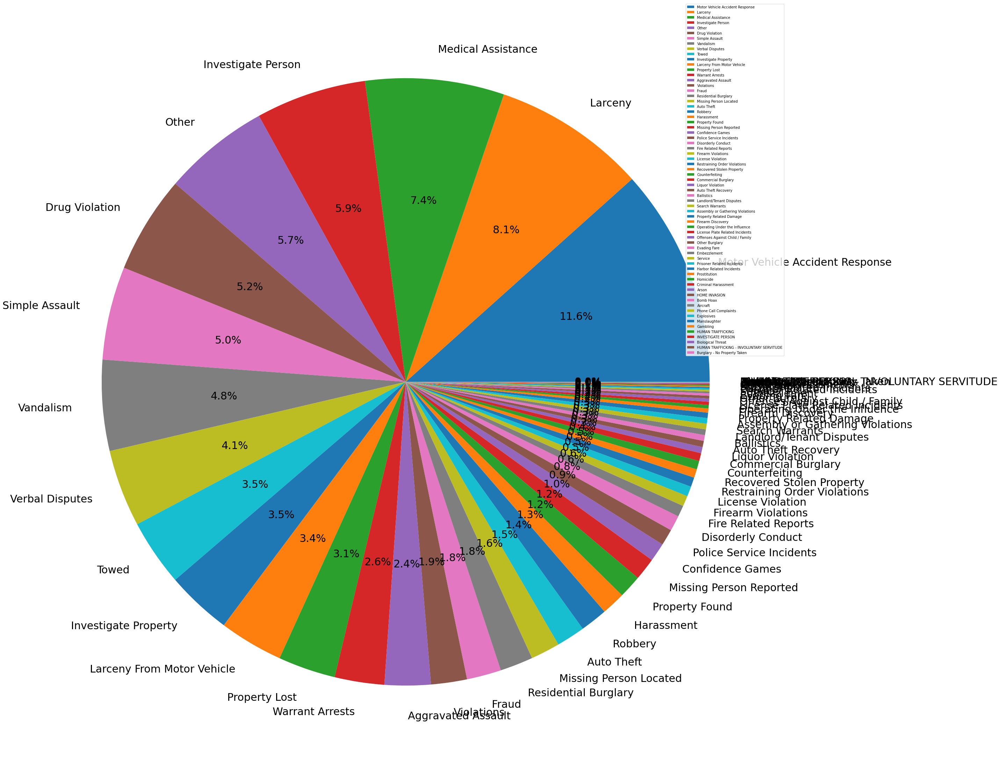

In [15]:
fig = plt.figure(figsize =(60, 40))
plt.pie(crimes_count, labels = crimes_count.index, autopct='%1.1f%%', textprops={'fontsize': 30})
plt.legend(loc = 'upper right')

<span style="color:#23CBE2;font-weight:700;font-size:20px">
   


# - - Section 2 - -
    
</span>
<hr/>

<div class="alert alert-info"> What percent of the murders involved a shooting? </div>

<hr/>

In [16]:
murder = crimes.loc[(crimes['OFFENSE_CODE'] == 111), ['OFFENSE_CODE', 'OFFENSE_CODE_GROUP', 'OFFENSE_DESCRIPTION', "SHOOTING", "OCCURRED_ON_DATE"]]
pershooting = murder.value_counts(murder["SHOOTING"] == True)

print("The percentage of murders that involved a shooting is", "{:.0%}".format(121/(121 + 40)))


The percentage of murders that involved a shooting is 75%


([<matplotlib.patches.Wedge at 0x7f8a8e46a400>,
 [Text(-0.7816026381075679, 0.7740137699700764, 'Crimes with shootings'),
  Text(0.7816027105759635, -0.7740136967911528, 'Crimes without shootings')],
 [Text(-0.426328711695037, 0.4221893290745871, '75.2%'),
  Text(0.4263287512232528, -0.4221892891588106, '24.8%')])

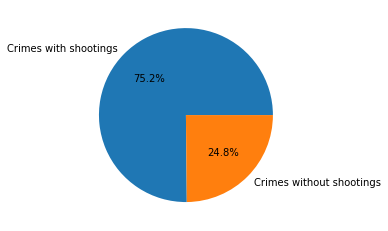

In [17]:
labels = ['Crimes with shootings', 'Crimes without shootings']

plt.pie(pershooting, labels = labels, autopct='%1.1f%%')


<span style="color:#23CBE2;font-weight:700;font-size:20px">
   


# - - Section 3 - -
    
</span>
<hr/>

<div class="alert alert-info"> What is the distribution of crime during the year? Is there a time when crime is most prevalent? </div>

<hr/>

Counting the crime days to see which days had the most crimes

In [18]:
day_counts = crimes.value_counts(crimes['OCCURRED_ON_DATE'])
day_counts

OCCURRED_ON_DATE
2017-06-01 00:00:00    29
2015-07-01 00:00:00    27
2016-08-01 00:00:00    27
2015-06-18 05:00:00    22
2017-08-01 00:00:00    22
2017-01-01 00:00:00    21
2015-12-07 11:38:00    20
2017-05-01 00:00:00    20
2016-04-01 00:00:00    20
2017-04-01 00:00:00    19
2016-09-01 00:00:00    19
2018-06-04 12:40:00    18
2015-12-01 00:00:00    18
2016-11-01 00:00:00    18
2017-07-05 00:00:00    18
2018-01-01 00:00:00    18
2017-11-01 00:00:00    17
2018-07-19 00:00:00    16
2016-02-01 00:00:00    16
2018-02-01 00:00:00    16
2017-03-01 00:00:00    15
2018-03-07 06:00:00    15
2018-08-18 08:45:00    15
2017-10-01 00:00:00    15
2015-06-20 00:00:00    14
2016-06-24 17:30:00    14
2016-12-15 06:00:00    14
2015-12-22 20:25:00    13
2015-10-02 21:00:00    13
2018-05-01 00:00:00    13
2015-08-01 00:00:00    13
2016-06-03 18:00:00    13
2015-07-17 00:00:00    13
2018-06-01 00:00:00    13
2018-03-01 00:00:00    13
2018-01-03 18:00:00    13
2018-04-02 00:00:00    13
2018-05-21 00:00:00  

Making a plot to see what the crime looks like over the whole time that the data was taken

A blockier version

<AxesSubplot:xlabel='OCCURRED_ON_DATE', ylabel='Count'>

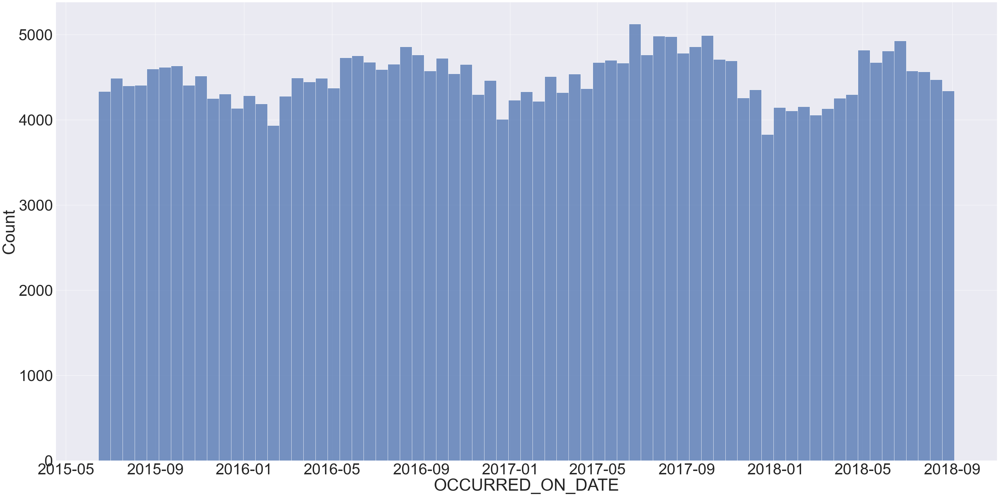

In [113]:
sns.histplot(data = crimes, x = "OCCURRED_ON_DATE")

A smoother version

<AxesSubplot:xlabel='OCCURRED_ON_DATE', ylabel='Density'>

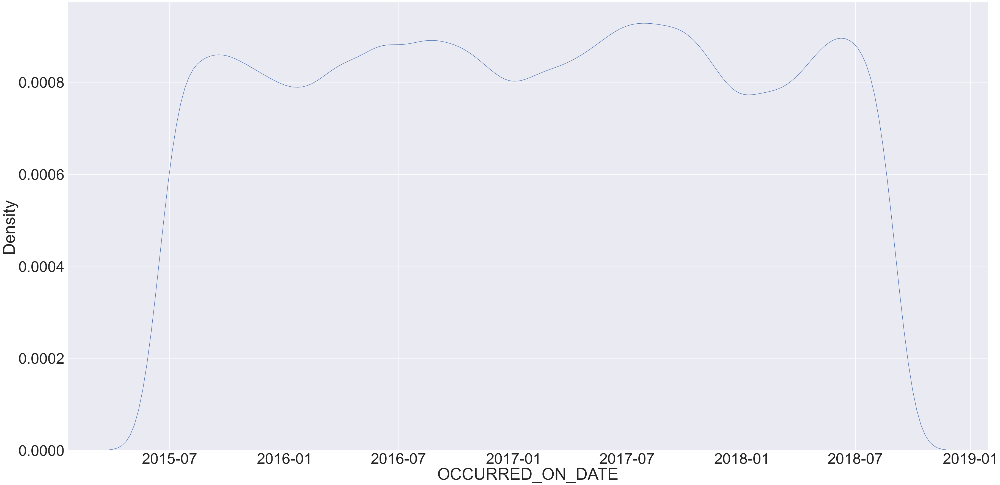

In [112]:
sns.kdeplot(data = crimes, x = "OCCURRED_ON_DATE")

Crime is definitely more prevalent during the summer, as you can see the graph go up in density around month 7 each year.

<span style="color:#23CBE2;font-weight:700;font-size:20px">
   


# - - Section 4 - -
    
</span>
<hr/>

<div class="alert alert-info"> What are the most common streets for crime? (no visualization) </div>

<hr/>

I was just curious. Here I'm just counting the amount of times that each street shows up in the dataset

In [19]:
street_counts = crimes.value_counts(crimes['STREET'])
street_counts

STREET
WASHINGTON ST                14194
BLUE HILL AVE                 7802
BOYLSTON ST                   7221
DORCHESTER AVE                5149
TREMONT ST                    4796
MASSACHUSETTS AVE             4735
HARRISON AVE                  4609
CENTRE ST                     4383
COMMONWEALTH AVE              4144
HYDE PARK AVE                 3470
COLUMBIA RD                   3195
HUNTINGTON AVE                2989
RIVER ST                      2831
DUDLEY ST                     2352
WARREN ST                     2336
COLUMBUS AVE                  2306
ADAMS ST                      2042
BEACON ST                     1966
NEWBURY ST                    1889
CAMBRIDGE ST                  1670
BOWDOIN ST                    1656
AMERICAN LEGION HWY           1631
W BROADWAY                    1630
GENEVA AVE                    1628
ALBANY ST                     1471
ALLSTATE RD                   1296
SUMMER ST                     1250
HANCOCK ST                    1246
NEW SUDBURY S

The street with the most crimes on it is Washington street. 

<span style="color:#23CBE2;font-weight:700;font-size:20px">
   


# - - Section 5 - -
    
</span>
<hr/>

<div class="alert alert-info"> What is the most common day for crime? </div>

<hr/>

Finding the value counts for all of the days of the week

In [57]:
days_counts = crimes.value_counts(crimes['DAY_OF_WEEK'])
days_counts

DAY_OF_WEEK
Friday       48495
Wednesday    46729
Thursday     46656
Tuesday      46383
Monday       45679
Saturday     44818
Sunday       40313
dtype: int64

Making a pie chart to represent the whole week. The day that has the most crime is separated by the rest using "explode"

([<matplotlib.patches.Wedge at 0x7f8a4559a4f0>,
 [Text(1.0657859749448875, 0.551452858919759, 'Friday'),
  Text(0.17062129929592146, 1.0866868786483859, 'Wednesday'),
  Text(-0.7607820018005025, 0.7944877253528971, 'Thursday'),
  Text(-1.0934724841905297, -0.11965753765723312, 'Tuesday'),
  Text(-0.5799728686686567, -0.9346825512484168, 'Monday'),
  Text(0.3623470378150956, -1.0386070595690298, 'Saturday'),
  Text(1.0144809141224942, -0.42523931483482214, 'Sunday')],
 [Text(0.6217084853845177, 0.32168083436985945, '15.2%'),
  Text(0.0930661632523208, 0.5927382974445741, '14.6%'),
  Text(-0.4149720009820922, 0.4333569411015802, '14.6%'),
  Text(-0.5964395368311979, -0.06526774781303625, '14.5%'),
  Text(-0.31634883745563086, -0.5098268461355, '14.3%'),
  Text(0.19764383880823394, -0.566512941583107, '14.0%'),
  Text(0.5533532258849967, -0.23194871718263022, '12.6%')])

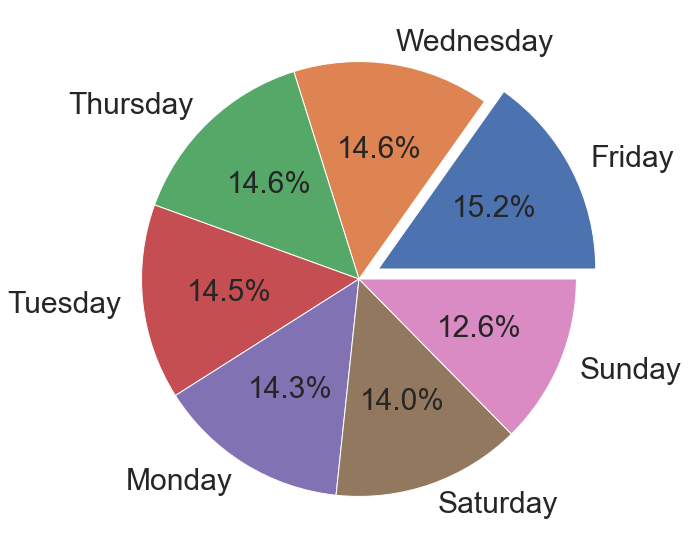

In [71]:
labels = ["Friday", "Wednesday", "Thursday", "Tuesday", "Monday", "Saturday", "Sunday"]
fig = plt.figure(1, figsize=(10,10))
explode = (0.1, 0, 0, 0, 0, 0, 0)
plt.pie(days_counts, labels = labels, autopct='%1.1f%%', textprops={'fontsize': 30}, explode=explode)

As you can see, Friday is the most common day for crime, and Sunday is the least common day for crime. 

<span style="color:#23CBE2;font-weight:700;font-size:20px">
   


# - - Section 6 - -
    
</span>
<hr/>

<div class="alert alert-info"> When is crime most prevalent during the day? </div>

<hr/>

<AxesSubplot:xlabel='HOUR', ylabel='Count'>

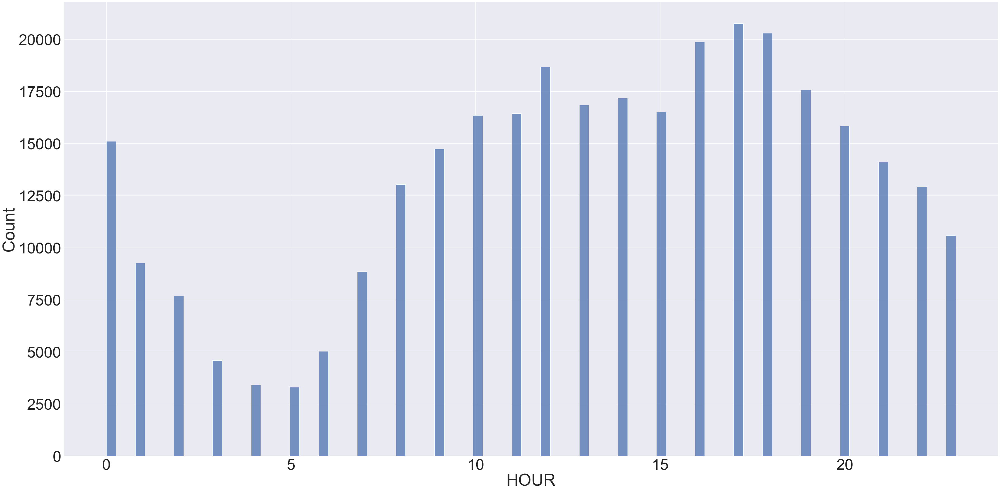

In [108]:
sns.histplot(data = crimes, x = "HOUR")

Crime is most prevalant during the later hours of the day. Specifically around 5:00

<AxesSubplot:xlabel='HOUR', ylabel='Density'>

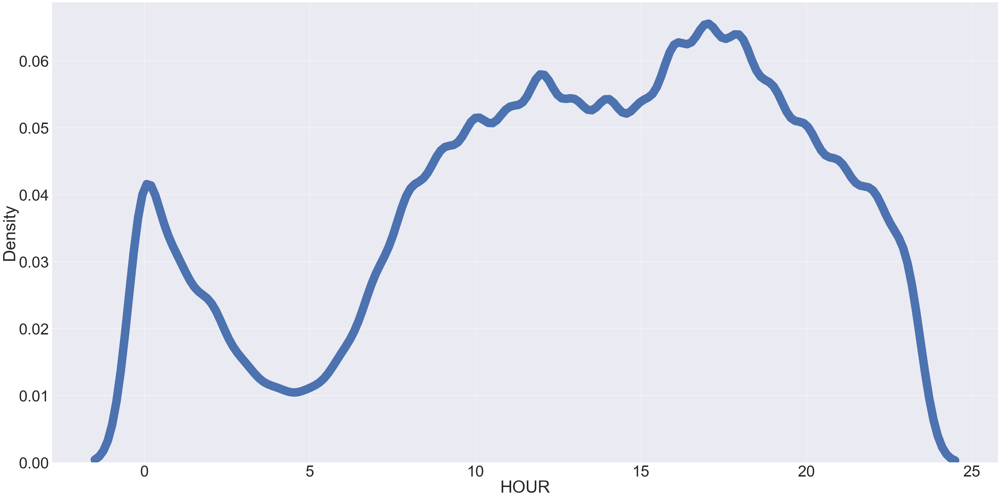

In [110]:
sns.kdeplot(data = crimes, x = "HOUR", lw = 30)

Smoother version of the plot